### Accelerated Data Analysis using Python
Ref. https://www.youtube.com/watch?v=lWXsyJm-ixo&list=PL3N9eeOlCrP6IjkyExZW9oZFwt-A1r0qB&index=13  
https://analyticsindiamag.com/tips-for-automating-eda-using-pandas-profiling-sweetviz-and-autoviz-in-python/

Software:
* SweetVIZ: https://pypi.org/project/sweetviz/
* AutoViz: https://github.com/AutoViML/AutoViz
* pandas-profiling: https://pandas-profiling.github.io/pandas-profiling/docs/master/rtd/

In [1]:
!pip3 install sweetviz
!pip3 install -U pandas-profiling
!pip3 install autoviz

al/lib/python3.8/site-packages (from pandas-profiling) (0.1.12)


In [2]:
import pandas as pd
import sweetviz as sv
from pandas_profiling import ProfileReport
from autoviz.AutoViz_Class import AutoViz_Class

#import warnings
#warnings.simplefilter(action='ignore', category=FutureWarning)

Imported AutoViz_Class version: 0.0.81. Call using:
    from autoviz.AutoViz_Class import AutoViz_Class
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 saves plots in your local machine under AutoViz_Plots directory and does not display charts.


In [3]:
df = pd.read_csv("http://www.creditriskanalytics.net/uploads/1/9/5/1/19511601/hmeq.csv")
df.head()

,BAD,LOAN,MORTDUE,VALUE,REASON,JOB,YOJ,DEROG,DELINQ,CLAGE,NINQ,CLNO,DEBTINC
0,1,1100,25860.0,39025.0,HomeImp,Other,10.5,0.0,0.0,94.366667,1.0,9.0,NaN
1,1,1300,70053.0,68400.0,HomeImp,Other,7.0,0.0,2.0,121.833333,0.0,14.0,NaN
2,1,1500,13500.0,16700.0,HomeImp,Other,4.0,0.0,0.0,149.466667,1.0,10.0,NaN
3,1,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,1700,97800.0,112000.0,HomeImp,Office,3.0,0.0,0.0,93.333333,0.0,14.0,NaN


```
◾ BAD: 1 = applicant defaulted on loan or seriously delinquent; 0 = applicant paid loan
◾ LOAN: Amount of the loan request
◾ MORTDUE: Amount due on existing mortgage
◾ VALUE: Value of current property
◾ REASON: DebtCon = debt consolidation; HomeImp = home improvement
◾ JOB: Occupational categories
◾ YOJ: Years at present job
◾ DEROG: Number of major derogatory reports
◾ DELINQ: Number of delinquent credit lines
◾ CLAGE: Age of oldest credit line in months
◾ NINQ: Number of recent credit inquiries
◾ CLNO: Number of credit lines
◾ DEBTINC: Debt-to-income ratio
```

### SweetVIZ

In [4]:
loan_report_sweetviz = sv.analyze(df, target_feat='BAD')

Done! Use 'show' commands to display/save.   |██████████| [100%]   00:01 -> (00:00 left)


In [5]:
# loan_report_sweetviz.show_notebook()
loan_report_sweetviz.show_html()

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


### AutoViz

In [6]:
loan_av = AutoViz_Class()

Shape of your Data Set: (5960, 13)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  9
    Number of Integer-Categorical Columns =  1
    Number of String-Categorical Columns =  1
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  1
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    12 Predictors classified...
        This does not include the Target column(s)
        No variables removed since no ID or low-information variables found in data set

################ Binary_Classification VISUALIZATION Started #####################
Data Set Shape: 5960 rows, 13 cols
Data Set columns info:
* LOAN: 0 nulls, 540 unique vals, most common: {15000: 105, 10000: 81}
* MORTDUE: 518 nulls, 

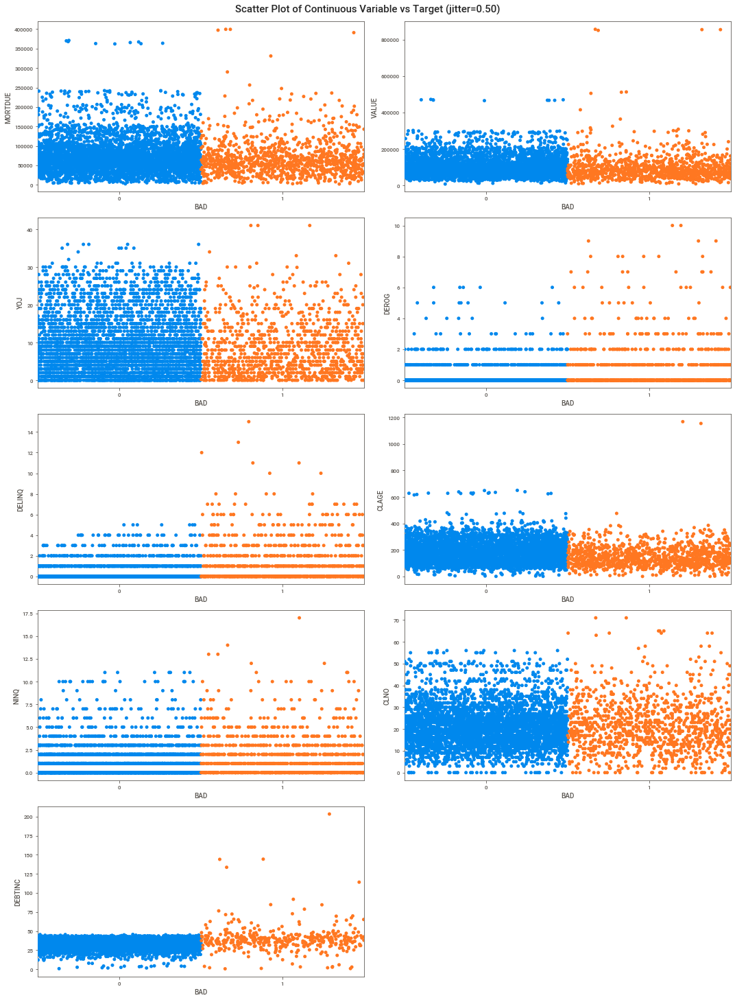

Total Number of Scatter Plots = 45


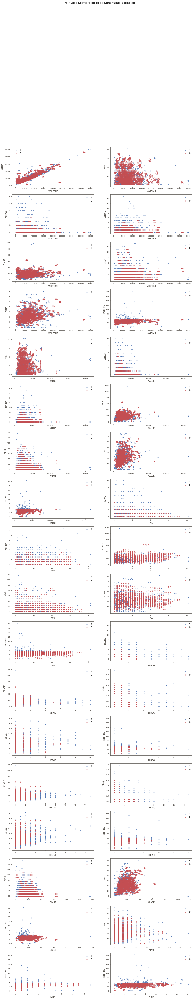

Could not draw Distribution Plots


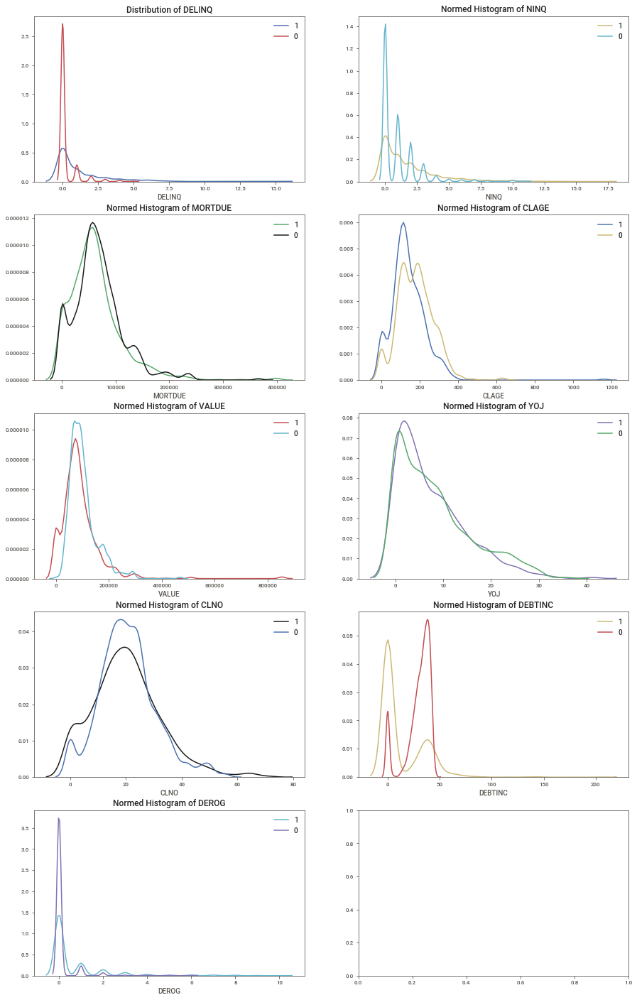

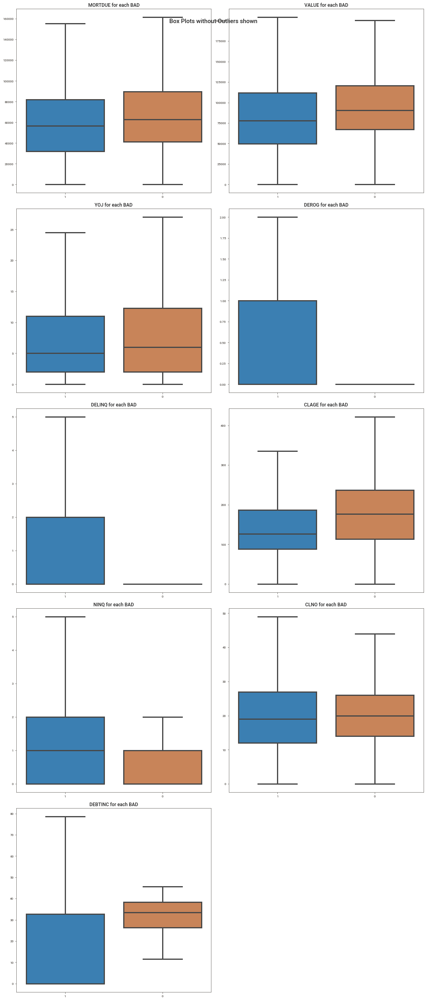

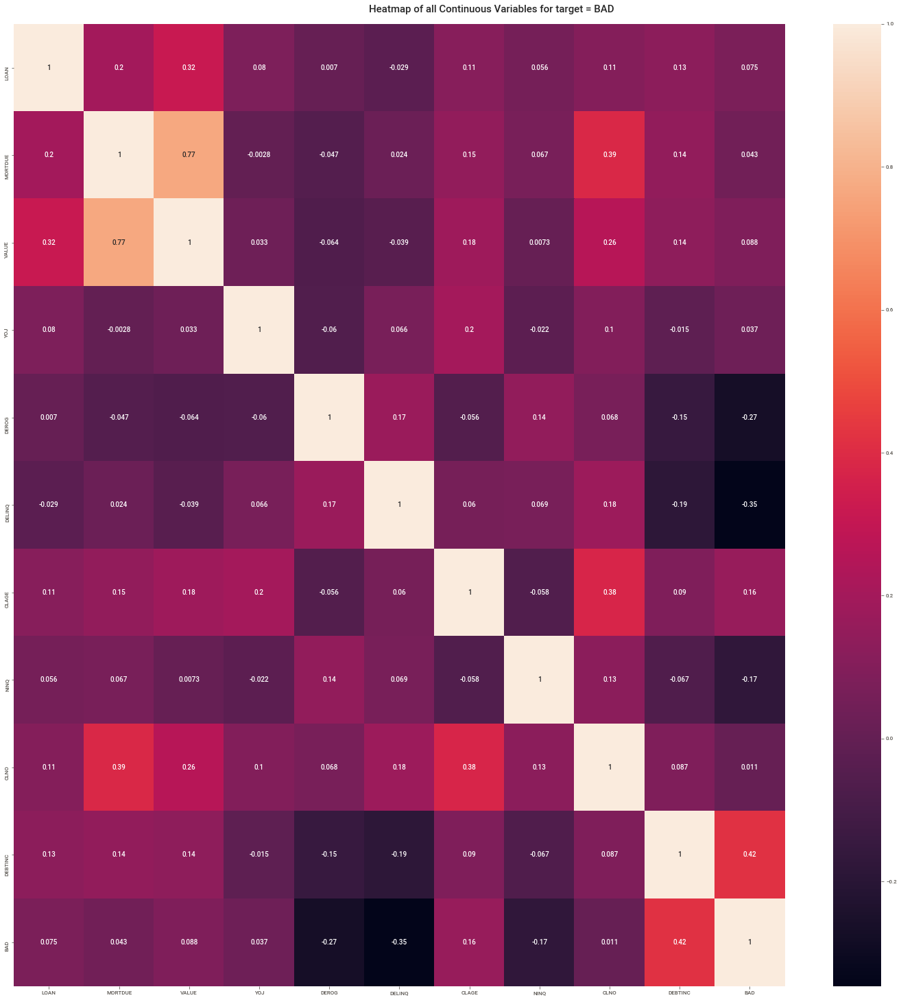

Could not draw Pivot Charts against Dependent Variable


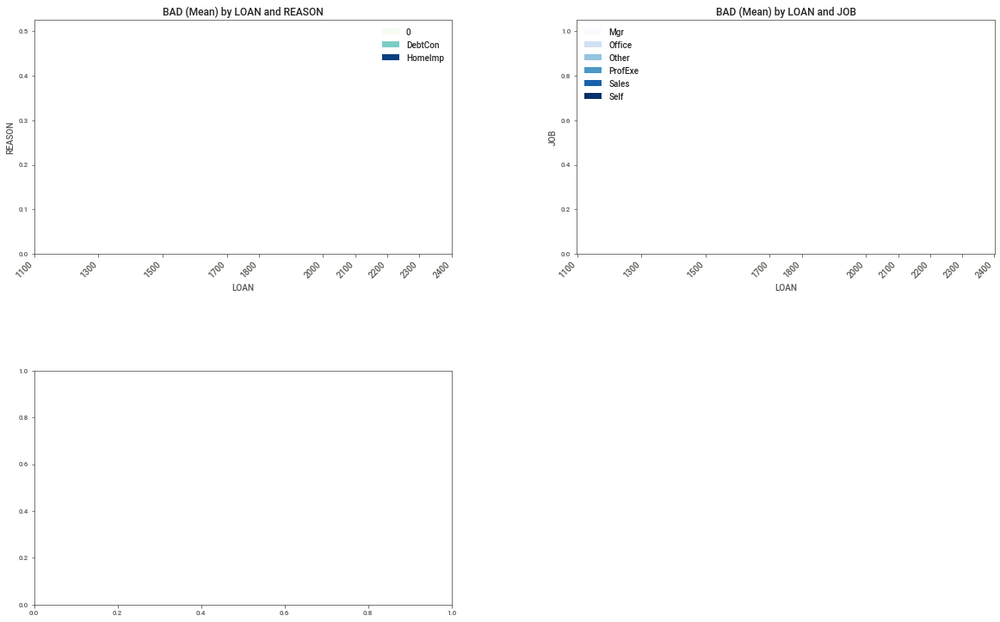

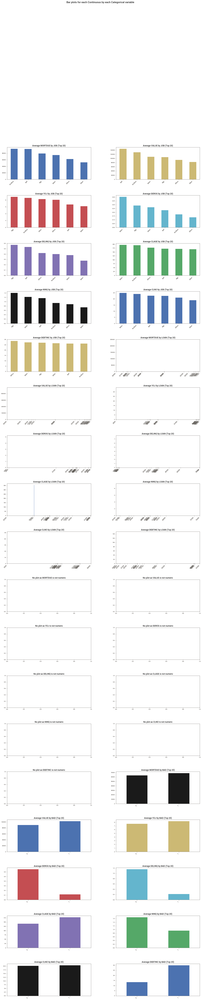

Time to run AutoViz (in seconds) = 83.219

 ###################### VISUALIZATION Completed ########################


In [7]:
dft = loan_av.AutoViz(
    filename='', dfte=df, depVar='BAD', 
    verbose=1, lowess=False, chart_format='svg'
)

### pandas_profiling

In [8]:
profile = ProfileReport(df, title='Loan Default Report', explorative=True)

In [9]:
# profile.to_notebook_iframe()

In [10]:
profile.to_file("loan_report_pandas_profiling.html")

Export report to file: 100%|██████████| 1/1 [00:00<00:00, 67.52it/s]
